# **Forecast of passenger in the New York subway**

In [11]:
import pandas as pd
import numpy as np
import datetime
import folium
import branca
#import shap
import math
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
import plotly.express as px
import plotly.graph_objects as go
from xgboost import XGBRegressor, XGBClassifier
from statsmodels.formula.api import ols
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant
from folium.plugins import HeatMap
from plotly.subplots import make_subplots
#from pygam import LinearGAM, s
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_squared_error, r2_score, confusion_matrix, accuracy_score, roc_auc_score, roc_curve
from sklearn.preprocessing import LabelEncoder, label_binarize
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor, plot_tree
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import Lasso

## Database preparation

In [4]:
# Load the Subway database
subway = pd.read_csv("./Subway/Données/Subway.csv", parse_dates = ['transit_timestamp'])

# Create two new columns: 'Date' and 'Hour'
subway['Date'] = subway['transit_timestamp'].dt.strftime('%Y-%m-%d')
subway['Hour'] = subway['transit_timestamp'].dt.strftime('%H:%M')

# Remove ":00" and convert to numeric
subway['Hour'] = subway['Hour'].str.replace(":00", "")
subway['Hour'] = pd.to_numeric(subway['Hour'])

# Filter the data for the specified period
start_date = pd.to_datetime("2022-02-01")
end_date = pd.to_datetime("2023-01-31")
subway = subway[(subway['transit_timestamp'] >= start_date) & (subway['transit_timestamp'] <= end_date)]

# Rename column "Borough"
borough_mapping = {'BK': 'Brooklyn', 'M': 'Manhattan', 'Q': 'Queens', 'BX': 'Bronx'}
subway['borough'] = subway['borough'].map(borough_mapping)

# Rename column "Station_complex_id"
subway = subway.rename(columns = {'station_complex_id': 'Booth'})

# Rearrange the columns
subway = subway[['Date', 'Hour', 'ridership', 'Booth', 'station_complex', 'borough', 'transfers']]

# Check the earliest and latest time
print(subway['Date'].min())
print(subway['Date'].max())

# Data with information of each station complex
station_line = pd.read_csv("./Subway/Données/Stations.csv")
station_line = station_line.rename(columns={'Complex ID': 'complex_id'})

station_info = pd.read_csv("./Subway/Données/Station_lookup.csv")
station_info['complex_id'] = station_info['complex_id'].fillna(0).astype(int)

# Merge
merged_df = pd.merge(station_line, station_info, on='complex_id', how='inner')
merged_df = merged_df.rename(columns = {'booth': 'Booth'})
merged_df = merged_df.rename(columns = {'Station ID': 'Station_complex_id'})
merged_df = merged_df.rename(columns = {'GTFS Latitude': 'Latitude'})
merged_df = merged_df.rename(columns = {'GTFS Longitude': 'Longitude'})
merged_df = merged_df[['Booth', 'Station_complex_id', 'Line', 'Latitude', 'Longitude', 'Structure']]

subway = pd.merge(subway, merged_df, on = 'Booth', how = 'inner')
subway = subway[['Date', 'Hour', 'ridership', 'Station_complex_id', 'station_complex', 'Booth', 'Line', 'borough', 'Structure', 'Latitude', 'Longitude']]
subway.rename(columns = {'borough': 'Borough'}, inplace = True)
subway['Date'] = pd.to_datetime(subway['Date'])

subway.head(3)

2022-02-01
2023-01-31


,Date,Hour,ridership,Station_complex_id,station_complex,Booth,Line,Borough,Structure,Latitude,Longitude
0,2022-06-05,4,21,356,"Church Av (2,5)",R639,Nostrand,Brooklyn,Subway,40.650843,-73.949575
1,2022-06-21,3,24,356,"Church Av (2,5)",R639,Nostrand,Brooklyn,Subway,40.650843,-73.949575
2,2022-07-05,3,23,356,"Church Av (2,5)",R639,Nostrand,Brooklyn,Subway,40.650843,-73.949575


In [5]:
# Load the Weather database
weather_nyc = pd.read_csv("./Subway/Données/Weather_NYC.csv")
weather_nyc['Date'] = pd.to_datetime(weather_nyc['Date'])
weather_nyc = weather_nyc[(weather_nyc['Date'] >= start_date) & (weather_nyc['Date'] <= end_date)]
weather_nyc.head(3)

,Borough,temperature (degC),dewpoint_temperature (degC),humidex_index (degC),wind_speed (m/s),surface_solar_radiation (W/m^2),total_cloud_cover (0-1),total_precipitation (mm of water equivalent),snowfall (mm of water equivalent),Date,Hour
744,Bronx,-4.49,-11.73,-8.65,2.43,0.0,0.01,0.0,0.0,2022-02-01,0
745,Bronx,-5.56,-11.70,-9.72,2.64,0.0,0.02,0.0,0.0,2022-02-01,1
746,Bronx,-6.69,-12.09,-10.89,2.76,0.0,0.11,0.0,0.0,2022-02-01,2


In [6]:
# Merge the two databases on the 'Date' and 'Hour' columns
merged_df = pd.merge(subway, weather_nyc, on=['Date', 'Hour', 'Borough'])

# Rename variables
column_mapping = {
    'station_complex': 'Station_complex',
    'ridership': 'Ridership',
    'temperature (degC)': 'Temperature_Celsius',
    'dewpoint_temperature (degC)': 'Dewpoint_Temperature_Celsius',
    'humidex_index (degC)': 'Humidex_Index_Celsius',
    'wind_speed (m/s)': 'Wind_Speed_ms',
    'surface_solar_radiation (W/m^2)': 'Surface_Solar_Radiation_Wm2',
    'total_cloud_cover (0-1)': 'Total_Cloud_Cover',
    'total_precipitation (mm of water equivalent)': 'Total_Precipitation_mm',
    'snowfall (mm of water equivalent)': 'Snowfall_mm'
}

# Rename DataFrame columns
merged_df = merged_df.rename(columns=column_mapping)

# Convert the "Date" column
merged_df['Date'] = pd.to_datetime(merged_df['Date'], format="%Y-%m-%d")

# Add a column for the month
merged_df['Month'] = merged_df['Date'].dt.month

# Add a column for the day
merged_df['Day'] = merged_df['Date'].dt.day

# Add a "Day_Of_Week" column with the day of the week
merged_df['Day_Of_Week'] = merged_df['Date'].dt.day_name()

# Add a column for the season
merged_df['Season'] = merged_df['Date'].dt.month.map({1: 'Winter', 2: 'Winter', 3: 'Spring', 
                                                      4: 'Spring', 5: 'Spring', 6: 'Summer', 
                                                      7: 'Summer', 8: 'Summer', 9: 'Autumn', 
                                                      10: 'Autumn', 11: 'Autumn', 12: 'Winter'})
# Holiday periods
holidays_periods = {
    'Midwinter Recess': ('2022-02-21', '2022-02-25'),
    'Spring Recess': ('2022-04-15', '2022-04-22'),
    'Summer 2022': ('2022-06-27', '2022-09-08'),
    'Rosh Hashanah': ('2022-09-26', '2022-09-27'),
    'Yom Kippur': ('2022-10-05', '2022-10-05'),
    'Thanksgiving': ('2022-11-24', '2022-11-25'),
    'Winter Recess': ('2022-12-26', '2023-01-02'),
    'Martin Luther King Jr. Day': ('2023-01-16', '2023-01-16'),
    'Midwinter Recess 2023': ('2023-02-20', '2023-02-24'),
    'Spring Recess 2023': ('2023-04-10', '2023-04-14'),
    'Summer 2023': ('2023-06-27', '2023-09-08')
}

# Create a 'Holiday' column with the corresponding days
merged_df['Holidays'] = np.select(
    [merged_df['Date'].between(start_date, end_date) for start_date, end_date in holidays_periods.values()],
    holidays_periods.keys(),
    default='Not Holidays'
)

# Replace holiday periods with 'Holidays'
holidays_to_replace = ['Summer 2022', 'Winter Recess', 'Spring Recess', 'Midwinter Recess',
                        'Thanksgiving', 'Rosh Hashanah', 'Yom Kippur', 'Martin Luther King Jr. Day']
merged_df.loc[merged_df['Holidays'].isin(holidays_to_replace), 'Holidays'] = 'Holidays'

# Save the merged DataFrame
merged_df.to_csv("./Subway/Données/MergedSubwayWeather.csv", index=False)

## Database description

In [13]:
subway = pd.read_csv("./Données/MergedSubwayWeather.csv")
subway['Date'] = pd.to_datetime(subway['Date'], format="%Y-%m-%d")
subway.head(3)

,Date,Hour,Ridership,Station_complex_id,Station_complex,Booth,Line,Borough,Structure,Latitude,...,Wind_Speed_ms,Surface_Solar_Radiation_Wm2,Total_Cloud_Cover,Total_Precipitation_mm,Snowfall_mm,Month,Day,Day_Of_Week,Season,Holidays
0,2022-06-05,4,21,356,"Church Av (2,5)",R639,Nostrand,Brooklyn,Subway,40.650843,...,2.39,0.0,0.0,0.0,0.0,6,5,Sunday,Summer,Not Holidays
1,2022-06-05,4,11,182,Ralph Av (C),N121B,8th Av - Fulton St,Brooklyn,Subway,40.678822,...,2.39,0.0,0.0,0.0,0.0,6,5,Sunday,Summer,Not Holidays
2,2022-06-05,4,4,241,"15 St-Prospect Park (F,G)",N542,6th Av - Culver,Brooklyn,Subway,40.660365,...,2.39,0.0,0.0,0.0,0.0,6,5,Sunday,Summer,Not Holidays


In [15]:
# Periode
print(subway['Date'].min())
print(subway['Date'].max())

2022-02-01 00:00:00
2023-01-31 00:00:00


In [16]:
# variable information
subway.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4034110 entries, 0 to 4034109
Data columns (total 24 columns):
 #   Column                        Dtype         
---  ------                        -----         
 0   Date                          datetime64[ns]
 1   Hour                          int64         
 2   Ridership                     int64         
 3   Station_complex_id            int64         
 4   Station_complex               object        
 5   Booth                         object        
 6   Line                          object        
 7   Borough                       object        
 8   Structure                     object        
 9   Latitude                      float64       
 10  Longitude                     float64       
 11  Temperature_Celsius           float64       
 12  Dewpoint_Temperature_Celsius  float64       
 13  Humidex_Index_Celsius         float64       
 14  Wind_Speed_ms                 float64       
 15  Surface_Solar_Radiation_Wm2   fl

We are 19 variables.

The temporal variables are: 
- ***Date***
- ***Hour***
- ***Month***
- ***Day***
- ***Day_Of_Week***
- ***Holidays***

The variables concerning metro stations are:
- ***Ridership*** : Total number of riders that entered a subway complex via OMNY or MetroCard at the specific hour and for that specific fare type.
- ***Station_complex_id*** : A unique identifier for station complexes
- ***Station_complex*** : The subway complex where an entry swipe or tap took place. Large subway complexes, such as Times Square and Fulton Center, may contain multiple subway lines. The subway complex name includes the routes that stop at the complex in parenthesis, such as Zerega Av (6).
- ***Borough*** : Represents one of the boroughs of New York City serviced by the subway system (Bronx, Brooklyn, Manhattan, Queens).
- ***Line*** : Subway lines that run through subway stations throughout the MTA area.

The weather variables are:
- ***Temperature_Celsius*** 
- ***Dewpoint_Temperature_Celsius*** 
- ***humidex_Index_Celsius*** 
- ***wind_Speed_m/s*** 
- ***surface_Solar_Radiation_Wm2*** 
- ***total_Cloud_Cover*** 
- ***total_Precipitation_mm*** 
- ***snowfall_mm***

In [17]:
# Number of subway station
print("There are", len(subway['Station_complex_id'].value_counts()), "stations.")

There are 459 stations.


In [18]:
print("There are", len(subway['Line'].value_counts()), "line.")

There are 33 line.


In [19]:
print("There are", len(subway['Borough'].unique()), "borough.")
print(subway['Borough'].value_counts())

There are 4 borough.
Brooklyn     1430914
Manhattan    1298351
Queens        701665
Bronx         603180
Name: Borough, dtype: int64


In [20]:
subway.describe()

,Hour,Ridership,Station_complex_id,Latitude,Longitude,Temperature_Celsius,Dewpoint_Temperature_Celsius,Humidex_Index_Celsius,Wind_Speed_ms,Surface_Solar_Radiation_Wm2,Total_Cloud_Cover,Total_Precipitation_mm,Snowfall_mm,Month,Day
count,4.034110e+06,4.034110e+06,4.034110e+06,4.034110e+06,4.034110e+06,4.034110e+06,4.034110e+06,4.034110e+06,4.034110e+06,4.034110e+06,4.034110e+06,4.034110e+06,4.034110e+06,4.034110e+06,4.034110e+06
mean,1.156185e+01,3.937425e+02,2.366486e+02,4.073111e+01,-7.393672e+01,1.364070e+01,7.510285e+00,1.494137e+01,3.514343e+00,1.734072e+02,5.499997e-01,1.241979e-01,2.920062e-03,6.543777e+00,1.567494e+01
std,6.894907e+00,9.328231e+02,1.373915e+02,7.655892e-02,5.595857e-02,9.305116e+00,9.474512e+00,1.298662e+01,1.741978e+00,2.512580e+02,4.108622e-01,4.434591e-01,4.979918e-02,3.441545e+00,8.773633e+00
min,0.000000e+00,1.000000e+00,1.000000e+00,4.057613e+01,-7.403088e+01,-1.297000e+01,-1.892000e+01,-1.774000e+01,5.000000e-02,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00,1.000000e+00
25%,6.000000e+00,3.600000e+01,1.180000e+02,4.067984e+01,-7.398221e+01,6.180000e+00,-2.200000e-01,4.060000e+00,2.250000e+00,0.000000e+00,8.000000e-02,0.000000e+00,0.000000e+00,4.000000e+00,8.000000e+00
50%,1.200000e+01,1.310000e+02,2.360000e+02,4.071953e+01,-7.394896e+01,1.333000e+01,8.590000e+00,1.386000e+01,3.210000e+00,8.070000e+00,6.200000e-01,0.000000e+00,0.000000e+00,7.000000e+00,1.600000e+01
75%,1.800000e+01,3.630000e+02,3.570000e+02,4.078143e+01,-7.390103e+01,2.155000e+01,1.577000e+01,2.624000e+01,4.490000e+00,3.045400e+02,9.900000e-01,1.000000e-02,0.000000e+00,1.000000e+01,2.300000e+01
max,2.300000e+01,2.224600e+04,4.770000e+02,4.090313e+01,-7.375540e+01,3.500000e+01,2.436000e+01,4.447000e+01,1.219000e+01,9.978300e+02,1.000000e+00,6.650000e+00,2.800000e+00,1.200000e+01,3.100000e+01


In [21]:
subway.describe(include = 'object')

,Station_complex,Booth,Line,Borough,Structure,Day_Of_Week,Season,Holidays
count,4034110,4034110,4034110,4034110,4034110,4034110,4034110,4034110
unique,420,420,33,4,5,7,4,2
top,"Times Sq-42 St (N,Q,R,W,S,1,2,3,7)/42 St (A,C,...",N060,8th Av - Fulton St,Brooklyn,Subway,Friday,Summer,Not Holidays
freq,43680,43680,406994,1430914,2413805,581849,1022200,2909276


## Data visualisation

### Subway map

In [22]:
# Remove temporal and weather data
subway_map = subway.drop(['Date', 'Hour', 'Temperature_Celsius', 'Wind_Speed_ms', 'Surface_Solar_Radiation_Wm2', 'Total_Cloud_Cover', 'Total_Precipitation_mm', 'Snowfall_mm', 'Month', 'Day', 'Day_Of_Week', 'Season', 'Holidays'], axis=1)

# Aggregate Ridership by Station_complex_id, calculating the mean while retaining other variables
subway_map = subway_map.groupby(['Station_complex_id', 'Station_complex', 'Booth', 'Line', 'Borough', 'Structure', 'Latitude', 'Longitude'])['Ridership'].mean().reset_index()
subway_map.head(3)

,Station_complex_id,Station_complex,Booth,Line,Borough,Structure,Latitude,Longitude,Ridership
0,1,"Astoria-Ditmars Blvd (N,W)",R515,Astoria,Queens,Elevated,40.775036,-73.912034,351.975962
1,2,"Astoria Blvd (N,W)",R514,Astoria,Queens,Elevated,40.770258,-73.917843,254.298993
2,3,"30 Av (N,W)",R513,Astoria,Queens,Elevated,40.766779,-73.921479,304.636103


In [23]:
# Set base map with folium
NYC_map = folium.Map(location=[40.712784, -74.005941], zoom_start=11)

# Prepare data for heatmap (convert latitude and longitude to a list of points)
heat_data = [[row['Latitude'], row['Longitude'], row['Ridership']] for _, row in subway_map.iterrows()]

# Create the HeatMap
HeatMap(
    data=heat_data,
    radius=15,
    blur=10,
).add_to(NYC_map)

# Display the map
NYC_map

### Graphics

In [24]:
# Passenger trend
mean_ridership = subway.groupby('Date')['Ridership'].mean().reset_index()

# Create a chart depicting the ridership evolution over days
fig = px.line(mean_ridership, x='Date', y='Ridership', title="Subway Ridership Evolution per Day")
fig.update_xaxes(title='Date')
fig.update_yaxes(title='Number of Passengers')

# Display the chart
fig.show()

In [25]:
# Assuming subway is your DataFrame
mean_week = subway.groupby('Day_Of_Week')['Ridership'].mean().reindex(
    ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']).reset_index()

# Create a Plotly Express bar chart with a gradient color
fig = px.bar(mean_week, x='Day_Of_Week', y='Ridership',
             labels={'x': 'Day of the Week', 'y': 'Average Number of Passengers'},
             title='Average Number of Passengers by Day',
             color='Ridership',  # Use the 'Ridership' column for coloring
             color_continuous_scale='Viridis')  # Specify the color scale

# Show the plot
fig.show()

In [26]:
# Assuming subway is your DataFrame
mean_hour = subway.groupby('Hour')['Ridership'].mean().reset_index()

# Create a Plotly Express bar chart
fig = px.bar(mean_hour, x='Hour', y='Ridership', color='Ridership',
             labels={'x': 'Hour', 'y': 'Mean Ridership'},
             title='Mean Ridership by Hour',
             color_continuous_scale='magma')

# Show the plot
fig.show()

In [27]:
# Group by 'Month' and 'Holidays' and calculate the mean 'Ridership'
mean_ridership_by_month = subway.groupby(['Month', 'Holidays'])['Ridership'].mean().reset_index()

# Assuming 'Month' column is in numerical format
mean_ridership_by_month['Month'] = mean_ridership_by_month['Month'].map({1: 'January', 2: 'February', 3: 'March', 4: 'April', 5: 'May', 6: 'June',
                                       7: 'July', 8: 'August', 9: 'September', 10: 'October', 11: 'November', 12: 'December'})

# Create a bar chart with specified colors
fig = px.bar(mean_ridership_by_month, x='Month', y='Ridership', color='Holidays',
             title='Ridership by Month and Holidays Status',
             labels={'Month': 'Month', 'Ridership': 'Ridership', 'Holidays': 'Holidays'},
             barmode='group',  # Use 'group' for side-by-side bars
             category_orders={'Month': ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']},  # Specify the order of months
             color_discrete_map={'Holidays': 'orange', 'Not Holidays': 'lightgreen'}  # Specify colors
            )
fig.show()

In [28]:
mean_temperature = subway.groupby('Date')['Temperature_Celsius'].mean().reset_index()

# Plotly Express bar chart
fig = px.bar(mean_temperature, x='Date', y='Temperature_Celsius',
             labels={'x': 'Date', 'y': 'Mean Temperature'},
             title='Mean Temperature by Days',
             color='Temperature_Celsius', color_continuous_scale='blues')
fig.show()

In [29]:
subway['Temperature_Interval'] = subway['Temperature_Celsius'] // 5 * 5

# Group by temperature intervals and calculate the mean ridership
mean_temp_interval = subway.groupby('Temperature_Interval')['Ridership'].mean().reset_index()

# Create a Plotly Express bar chart for temperature intervals
fig_temp = px.bar(mean_temp_interval, x='Temperature_Interval', y='Ridership',
                  labels={'x': 'Temperature Interval', 'y': 'Mean Ridership'},
                  title='Mean Ridership by Temperature Interval',
                  color='Ridership', color_continuous_scale='magma')

# Show the plot
fig_temp.show()

In [30]:
mean_seasons = subway.groupby('Season').agg(mean_Ridership=('Ridership', 'mean'),
                                            mean_temperature=('Temperature_Celsius', 'mean')).reset_index()

# Plotly Express bar chart with color scale
fig = px.bar(mean_seasons, x='Season', y='mean_Ridership', color='mean_temperature',
             labels={'x': 'Season', 'y': 'Mean Ridership', 'mean_temperature': 'Mean Temperature (°C)'},
             title='Mean Ridership by Season and Temperature',
             color_continuous_scale='RdBu_r') 
fig.show()

In [31]:
# Count the number of unique values in 'Station_complex_id' per 'Borough'
count_station_by_borough = subway.groupby('Borough')['Station_complex_id'].nunique()

# Calculate the mean of 'Ridership' per 'Borough'
count_ridership_by_borough = subway.groupby('Borough')['Ridership'].mean()

# Merge the two series into a single DataFrame
result_df = pd.merge(count_station_by_borough, count_ridership_by_borough, on='Borough').reset_index()

result_df

,Borough,Station_complex_id,Ridership
0,Bronx,70,147.249735
1,Brooklyn,166,202.114526
2,Manhattan,142,793.457651
3,Queens,81,256.799788


In [32]:
# Dual-axis chart
fig = make_subplots(specs=[[{"secondary_y": True}]])
fig.add_trace(go.Bar(x=result_df['Borough'], y=result_df['Station_complex_id'], name='Station_complex_id'), secondary_y=False)
fig.add_trace(go.Scatter(x=result_df['Borough'], y=result_df['Ridership'], mode='lines+markers', name='Ridership'), secondary_y=True)
fig.update_layout(title='Number of Passengers and Stations per Borough',
                  yaxis=dict(title='Station_complex_id', color='blue'),
                  yaxis2=dict(title='Ridership', overlaying='y', side='right', color='red'))

fig.show()

In [33]:
mean_line = subway.groupby(['Line', 'Borough'])[['Ridership']].mean().reset_index()

# Treemap with Plotly Express
fig = px.treemap(mean_line, 
                 path=['Line'], 
                 values='Ridership', 
                 labels={'Line': 'Line', 'Borough': 'Borough', 'Ridership': 'Mean Ridership'},
                 title='Mean Ridership by Subway Line')
fig.show()

/usr/lib/python3/dist-packages/plotly/express/_core.py:1637: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



## Preparation of the database: Normalization of data & variables selection

We want to predict the number of crowds per metro line according to the day, time and weather variables.

In [34]:
# Aggregation by 'Line' using the sum of 'Ridership' and the mean of the weather variables
subway = subway.groupby(['Line', 'Date', 'Hour', 'Month', 'Day', 'Day_Of_Week', 'Season', 'Holidays']).agg({
    'Ridership': 'sum',
    'Temperature_Celsius': 'mean',
    'Dewpoint_Temperature_Celsius': 'mean',
    'Humidex_Index_Celsius': 'mean',
    'Wind_Speed_ms': 'mean',
    'Surface_Solar_Radiation_Wm2': 'mean',
    'Total_Cloud_Cover': 'mean',
    'Total_Precipitation_mm': 'mean',
    'Snowfall_mm': 'mean'
}).reset_index()

subway.head(3)

,Line,Date,Hour,Month,Day,Day_Of_Week,Season,Holidays,Ridership,Temperature_Celsius,Dewpoint_Temperature_Celsius,Humidex_Index_Celsius,Wind_Speed_ms,Surface_Solar_Radiation_Wm2,Total_Cloud_Cover,Total_Precipitation_mm,Snowfall_mm
0,4th Av,2022-02-01,0,2,1,Tuesday,Winter,Not Holidays,236,-4.98,-11.22,-9.08,3.29,0.0,0.03,0.0,0.0
1,4th Av,2022-02-01,1,2,1,Tuesday,Winter,Not Holidays,73,-6.08,-11.31,-10.20,3.50,0.0,0.05,0.0,0.0
2,4th Av,2022-02-01,2,2,1,Tuesday,Winter,Not Holidays,75,-6.77,-11.44,-10.90,3.56,0.0,0.19,0.0,0.0


In [35]:
# Conversion of categorical variables
label_encoder = LabelEncoder()
subway['Line'] = label_encoder.fit_transform(subway['Line'])
subway['Season'] = label_encoder.fit_transform(subway['Season'])
subway['Day_Of_Week'] = label_encoder.fit_transform(subway['Day_Of_Week'])
subway['Holidays'] = label_encoder.fit_transform(subway['Holidays'])

### Correlation matrix

For the analyses, it is relevant to observe the correlations between our different variables. It is necessary to avoid the problem of multicollinearity caused by a strong correlation between variables

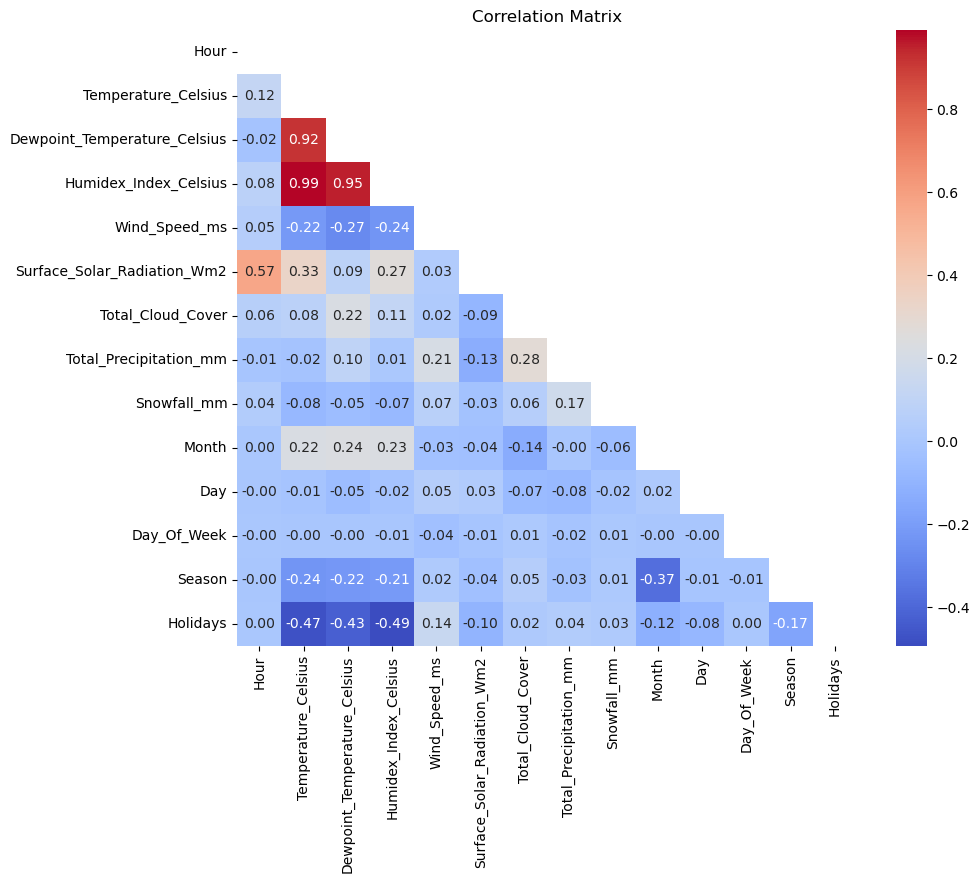

In [36]:
# Select only continuous variables
correlation_var = subway[["Hour", "Temperature_Celsius", 
                          "Dewpoint_Temperature_Celsius", 
                          "Humidex_Index_Celsius", "Wind_Speed_ms", 
                          "Surface_Solar_Radiation_Wm2", 
                          "Total_Cloud_Cover", 
                          "Total_Precipitation_mm", 
                          "Snowfall_mm", "Month", "Day", 
                          "Day_Of_Week", "Season", "Holidays"]]

# Calculate the correlation matrix
matrice_correlation = correlation_var.corr()

# Create a mask to hide the upper triangular part
mask = np.triu(np.ones_like(matrice_correlation, dtype=bool))

# Display the correlation matrix with masked upper triangle and annotations
plt.figure(figsize=(10, 8))
sns.heatmap(matrice_correlation, cmap="coolwarm", mask=mask, annot=True, fmt=".2f")
plt.title("Correlation Matrix")
plt.show()

The variables Temperature_Celsius, Dewpoint_Temperature_Celsius and Humidex_Index_Celsius are strongly correlated. We decide to keep only the Temperature_Celsius variable.

### Dispersion matrix

A dispersion matrix of different variables on the Ridership variable, allows us to visualize the linearity and complexity of the relationships

In [37]:
# Downsampling to reduce dataset size
subway_sampled = subway.sample(frac=0.1, random_state=42)

In [38]:
# Matrix of five plots
fig = make_subplots(rows=2, cols=3, row_heights=[0.6, 0.6])

variables = ['Temperature_Celsius', 'Wind_Speed_ms', 'Surface_Solar_Radiation_Wm2',
             'Total_Cloud_Cover', 'Total_Precipitation_mm', 'Snowfall_mm']

# Loop for each variables
for i, var in enumerate(variables, start=1):
    X_var = subway_sampled[var].values.reshape(-1, 1)
    y_var = subway_sampled['Ridership'].values

    gam_model_var = LinearGAM(s(0, n_splines=20)).fit(X_var, y_var)

    X_grid_var = np.linspace(X_var.min(), X_var.max(), 100).reshape(-1, 1)
    y_pred_var = gam_model_var.predict(X_grid_var)

    row_num = (i - 1) // 3 + 1
    col_num = (i - 1) % 3 + 1

    trace1 = go.Scatter(x=subway_sampled[var], y=subway_sampled['Ridership'],
                       mode='markers', marker=dict(color='black', size=5), opacity=0.6)

    trace2 = go.Scatter(x=X_grid_var.flatten(), y=y_pred_var.flatten(),
                        mode='lines', line=dict(color='red'))

    fig.add_trace(trace1, row=row_num, col=col_num)
    fig.add_trace(trace2, row=row_num, col=col_num)

    fig.update_xaxes(title_text=var, row=row_num, col=col_num)
    fig.update_yaxes(row=row_num, col=col_num)

fig.update_layout(title_text="Dispersion Matrix on 'Ridership'", height=800)
fig.show()

NameError: name 'LinearGAM' is not defined

### Distribution of variables

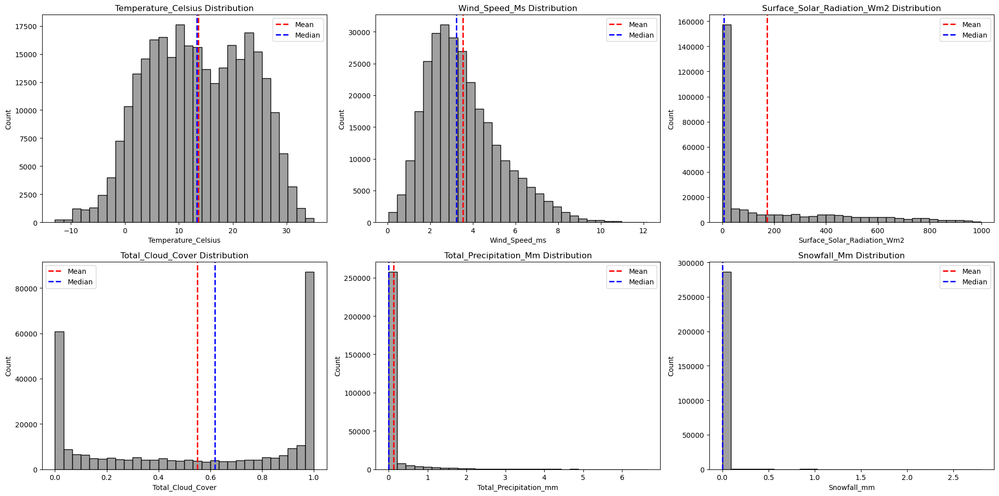

In [39]:
# Variables to analyze
variables = ['Temperature_Celsius', 'Wind_Speed_ms', 'Surface_Solar_Radiation_Wm2',
             'Total_Cloud_Cover', 'Total_Precipitation_mm', 'Snowfall_mm']

# Plotting numerical data to analyze the distribution
fig = plt.figure(figsize = (20, 10))

for idx, variable in enumerate(variables):
    plt.subplot(2, 3, idx + 1)
    sns.histplot(subway[variable], kde = False, color = 'grey', bins = 30)
    
    mean_value = subway[variable].mean()
    median_value = subway[variable].median()
    
    plt.axvline(mean_value, color = 'red', linestyle = 'dashed', linewidth = 2, label = 'Mean')
    plt.axvline(median_value, color = 'blue', linestyle = 'dashed', linewidth = 2, label = 'Median')
    
    plt.title(f'{variable.title()} Distribution')
    plt.legend()

plt.tight_layout()
plt.show()

Overall, the variables have their mean which is equal to their median. This phenomenon suggests that the distribution of the variable is symmetrical, or normal.
However, the variable 'solar_radiation' has a median close to 0 and a mean close to 200, this suggests a significant concentration of values ​​near zero and a number of higher values ​​that pull the mean up.
We do not take this into account, because there may be a large number of days when the weather is not good. This should not involve any complications in our analyses.

### Anova significance test

In [40]:
# Formula for the model
formula = 'Ridership ~ Line + Temperature_Celsius + Wind_Speed_ms + Surface_Solar_Radiation_Wm2 + Total_Cloud_Cover + Total_Precipitation_mm + Snowfall_mm + Month + Day + Day_Of_Week + Hour + Season + Holidays'

# OLS Model
model_anova = ols(formula, data=subway).fit()

# ANOVA Test
anova_table = sm.stats.anova_lm(model_anova, typ=2)

# Round p-values and F-values
anova_table['PR(>F)'] = anova_table['PR(>F)'].round(4)
anova_table['F'] = anova_table['F'].round(4)

# Significance stars
anova_table['Significance'] = anova_table['PR(>F)'].apply(lambda p: '' if p > 0.05 else '****' if p <= 0.001 else '***' if p <= 0.01 else '**' if p <= 0.05 else '*')

anova_table

,sum_sq,df,F,PR(>F),Significance
Line,2.032544e+12,1.0,27922.7644,0.0000,****
Temperature_Celsius,6.997178e+10,1.0,961.2611,0.0000,****
Wind_Speed_ms,2.861850e+10,1.0,393.1564,0.0000,****
Surface_Solar_Radiation_Wm2,6.573409e+11,1.0,9030.4449,0.0000,****
Total_Cloud_Cover,2.217556e+10,1.0,304.6443,0.0000,****
Total_Precipitation_mm,1.005597e+10,1.0,138.1474,0.0000,****
Snowfall_mm,8.425009e+06,1.0,0.1157,0.7337,
Month,6.214168e+10,1.0,853.6925,0.0000,****
Day,4.899301e+05,1.0,0.0067,0.9346,
Day_Of_Week,4.346407e+10,1.0,597.1025,0.0000,****


### Variables selection

In [41]:
selected_features = ['Line', 'Temperature_Celsius', 
                     'Wind_Speed_ms', 'Surface_Solar_Radiation_Wm2', 
                     'Total_Cloud_Cover', 'Total_Precipitation_mm', 
                     'Month', 'Day_Of_Week', 'Hour', 'Season', 'Holidays']

## Division of the database into training and test data

In [42]:
# Random seed for reproducibility
seed = 123

# Base division: 70% for training, 30% for testing
train_data, test_data = train_test_split(subway, test_size=0.3, random_state=seed)

In [43]:
# Verification
print("The description of the training base is:")
train_data.describe()

The description of the training base is:


,Line,Hour,Month,Day,Day_Of_Week,Season,Holidays,Ridership,Temperature_Celsius,Dewpoint_Temperature_Celsius,Humidex_Index_Celsius,Wind_Speed_ms,Surface_Solar_Radiation_Wm2,Total_Cloud_Cover,Total_Precipitation_mm,Snowfall_mm
count,201788.000000,201788.000000,201788.000000,201788.000000,201788.000000,201788.000000,201788.000000,201788.000000,201788.000000,201788.000000,201788.000000,201788.000000,201788.000000,201788.000000,201788.000000,201788.000000
mean,15.992884,11.525690,6.532762,15.686632,2.998424,1.494296,0.722179,5506.285468,13.623308,7.493014,14.917827,3.536958,172.563301,0.550417,0.123907,0.002911
std,9.521239,6.926201,3.442316,8.772671,2.000460,1.112784,0.447926,9231.335104,9.293402,9.479202,12.977526,1.743917,250.761872,0.410838,0.440528,0.049068
min,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,1.000000,-12.938333,-18.920000,-17.700000,0.050000,0.000000,0.000000,0.000000,0.000000
25%,8.000000,6.000000,4.000000,8.000000,1.000000,1.000000,0.000000,492.000000,6.190942,-0.230000,4.050536,2.270000,0.000000,0.079189,0.000000,0.000000
50%,16.000000,12.000000,7.000000,16.000000,3.000000,1.000000,1.000000,1753.000000,13.317750,8.560000,13.832582,3.230000,7.369730,0.620000,0.000000,0.000000
75%,24.000000,18.000000,10.000000,23.000000,5.000000,2.000000,1.000000,5999.000000,21.540000,15.756764,26.190000,4.520000,302.092500,0.990000,0.010000,0.000000
max,32.000000,23.000000,12.000000,31.000000,6.000000,3.000000,1.000000,98644.000000,35.000000,24.360000,44.470000,12.190000,997.830000,1.000000,6.650000,2.800000


In [44]:
print("The description of the test base is:")
test_data.describe()

The description of the test base is:


,Line,Hour,Month,Day,Day_Of_Week,Season,Holidays,Ridership,Temperature_Celsius,Dewpoint_Temperature_Celsius,Humidex_Index_Celsius,Wind_Speed_ms,Surface_Solar_Radiation_Wm2,Total_Cloud_Cover,Total_Precipitation_mm,Snowfall_mm
count,86481.000000,86481.000000,86481.000000,86481.000000,86481.000000,86481.000000,86481.000000,86481.000000,86481.000000,86481.000000,86481.000000,86481.000000,86481.000000,86481.000000,86481.000000,86481.000000
mean,16.015125,11.440675,6.560354,15.667002,3.004475,1.486627,0.723292,5519.110857,13.664162,7.557182,14.979312,3.528680,171.504016,0.547239,0.124310,0.002866
std,9.523980,6.913177,3.436798,8.774969,1.999443,1.114059,0.447374,9348.312973,9.279156,9.446772,12.957244,1.746672,250.796311,0.410256,0.446224,0.050281
min,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,1.000000,-12.970000,-18.920000,-17.740000,0.050000,0.000000,0.000000,0.000000,0.000000
25%,8.000000,5.000000,4.000000,8.000000,1.000000,0.000000,0.000000,486.000000,6.232857,-0.160000,4.110000,2.260000,0.000000,0.077872,0.000000,0.000000
50%,16.000000,11.000000,7.000000,16.000000,3.000000,1.000000,1.000000,1745.000000,13.380000,8.624643,13.960000,3.217586,6.960000,0.610000,0.000000,0.000000
75%,24.000000,17.000000,10.000000,23.000000,5.000000,2.000000,1.000000,5973.000000,21.543333,15.810000,26.220000,4.515862,299.250000,0.990000,0.010000,0.000000
max,32.000000,23.000000,12.000000,31.000000,6.000000,3.000000,1.000000,100208.000000,35.000000,24.360000,44.470000,12.190000,997.830000,1.000000,6.650000,2.800000


The training and test base are statistically similar

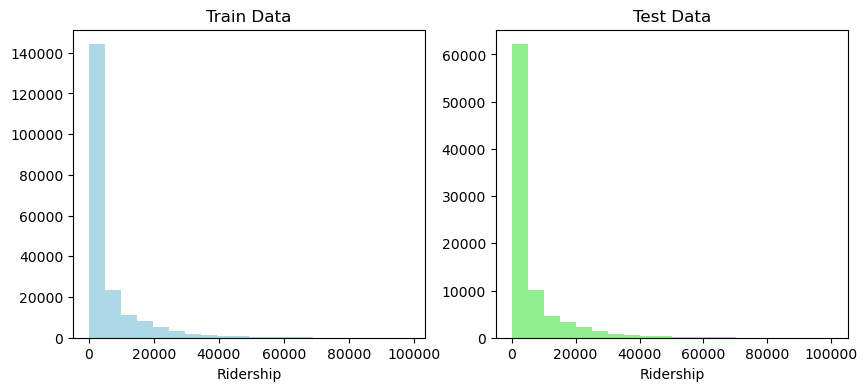

In [45]:
# Comparison of Ridership distributions between train and test
plt.figure(figsize=(10, 4))
plt.subplot(1, 2, 1)
plt.hist(train_data['Ridership'], color='lightblue', bins=20)
plt.title('Train Data')
plt.xlabel('Ridership')

plt.subplot(1, 2, 2)
plt.hist(test_data['Ridership'], color='lightgreen', bins=20)
plt.title('Test Data')
plt.xlabel('Ridership')

plt.show()

In [46]:
train_data['Dataset'] = 'Train Data'
test_data['Dataset'] = 'Test Data'
combined_data = pd.concat([train_data, test_data])

fig = px.histogram(combined_data, x='Ridership', color='Dataset', marginal='box',
                   labels={'Ridership': 'Ridership'},
                   nbins=20, opacity=0.7,
                   template='plotly_white')

fig.update_layout(
    title_text='Comparison of Ridership distributions between train and test',
    xaxis_title='Ridership',
    showlegend=True
)

fig.show()

## Parametrics models

### Linear regression model

In [47]:
# Linear regression model
ols_model = sm.OLS(train_data['Ridership'], train_data[selected_features]).fit()
print(ols_model.summary())

                                 OLS Regression Results                                
Dep. Variable:              Ridership   R-squared (uncentered):                   0.364
Model:                            OLS   Adj. R-squared (uncentered):              0.364
Method:                 Least Squares   F-statistic:                          1.052e+04
Date:                Mon, 01 Apr 2024   Prob (F-statistic):                        0.00
Time:                        10:52:55   Log-Likelihood:                     -2.1137e+06
No. Observations:              201788   AIC:                                  4.227e+06
Df Residuals:                  201777   BIC:                                  4.228e+06
Df Model:                          11                                                  
Covariance Type:            nonrobust                                                  
                                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------

In [48]:
# Model evaluation
linear_predictions_train = ols_model.predict(train_data[selected_features])
linear_predictions_test = ols_model.predict(test_data[selected_features])

# Displaying predictions on test_data
test_data['linear_predictions'] = linear_predictions_test
print(test_data[['Ridership', 'linear_predictions']])

# Metrics evaluation
r2_linear_model = r2_score(test_data['Ridership'], linear_predictions_test)
print("R-squared (R2):", r2_linear_model)

mse_linear_train = mean_squared_error(train_data['Ridership'], linear_predictions_train)
mse_linear_test = mean_squared_error(test_data['Ridership'], linear_predictions_test)
ecart_mse_linear = mse_linear_test - mse_linear_train

print("\nMean Squared Error on training set:", mse_linear_train)
print("Mean Squared Error on validation set:", mse_linear_test)
print("\nThe difference between the two MSE is:", ecart_mse_linear)

        Ridership  linear_predictions
190997        816         4934.812366
36058        4507         6003.904780
278620        156         2043.329451
178524      20439         6808.915505
24913         711        10024.031409
...           ...                 ...
53947       20273        10992.550616
47053        6498        11857.944888
196876        755         1343.805117
236311        201         -554.377405
253159         99         -442.027681

[86481 rows x 2 columns]
R-squared (R2): 0.13992324596351957

Mean Squared Error on training set: 73427412.25737481
Mean Squared Error on validation set: 75162060.16539988

The difference between the two MSE is: 1734647.908025071


### Information reduction method: Lasso

In [49]:
# Lasso model parameter set to 0.1
alpha_lasso = 0.1

# Creating the Lasso model
lasso = Lasso(alpha=alpha_lasso)

# Training the model
lasso_model = lasso.fit(train_data[selected_features], train_data['Ridership'])

# Extracting coefficients and intercept
coefficients = lasso_model.coef_
intercept = lasso_model.intercept_

# Creating a summary DataFrame
lasso_summary = pd.DataFrame({
    'Variable': selected_features,
    'Coefficient': coefficients
})

print(lasso_summary)

                       Variable  Coefficient
0                          Line  -277.453373
1           Temperature_Celsius   -72.514161
2                 Wind_Speed_ms  -190.935655
3   Surface_Solar_Radiation_Wm2     8.104508
4             Total_Cloud_Cover   723.775241
5        Total_Precipitation_mm   476.740996
6                         Month   156.022794
7                   Day_Of_Week   177.966965
8                          Hour   109.607286
9                        Season   -67.381202
10                     Holidays   380.430457


In [50]:
# Model evaluation
lasso_predictions_train = lasso_model.predict(train_data[selected_features])
lasso_predictions_test = lasso_model.predict(test_data[selected_features])

# Displaying predictions on test_data
test_data['lasso_predictions'] = lasso_predictions_test
print(test_data[['Ridership', 'lasso_predictions']])

# Metrics evaluation
r2_lasso_model = r2_score(test_data['Ridership'], lasso_predictions_test)
print("R-squared (R2):", r2_lasso_model)

mse_lasso_train = mean_squared_error(train_data['Ridership'], lasso_predictions_train)
mse_lasso_test = mean_squared_error(test_data['Ridership'], lasso_predictions_test)
ecart_mse_lasso = mse_lasso_test - mse_lasso_train

print("\nMean Squared Error on training set:", mse_lasso_train)
print("Mean Squared Error on validation set:", mse_lasso_test)
print("\nThe difference between the two MSE is:", ecart_mse_lasso)

        Ridership  lasso_predictions
190997        816        3853.309596
36058        4507        7369.980315
278620        156         -88.131751
178524      20439        6870.954554
24913         711        8237.308578
...           ...                ...
53947       20273       11068.379781
47053        6498       11297.104224
196876        755        2092.066660
236311        201       -1026.731376
253159         99        -847.734871

[86481 rows x 2 columns]
R-squared (R2): 0.15305522966006613

Mean Squared Error on training set: 72265076.42484267
Mean Squared Error on validation set: 74014456.8334198

The difference between the two MSE is: 1749380.4085771292


#### SHAP interpretability

In [70]:
# Converting test data to numpy format
test_data_np = test_data[selected_features].values

# Creating a SHAP explainer with the Lasso model
explainer = shap.Explainer(lasso_model, test_data_np)

# SHAP values for all observations
shap_values = explainer.shap_values(test_data_np)

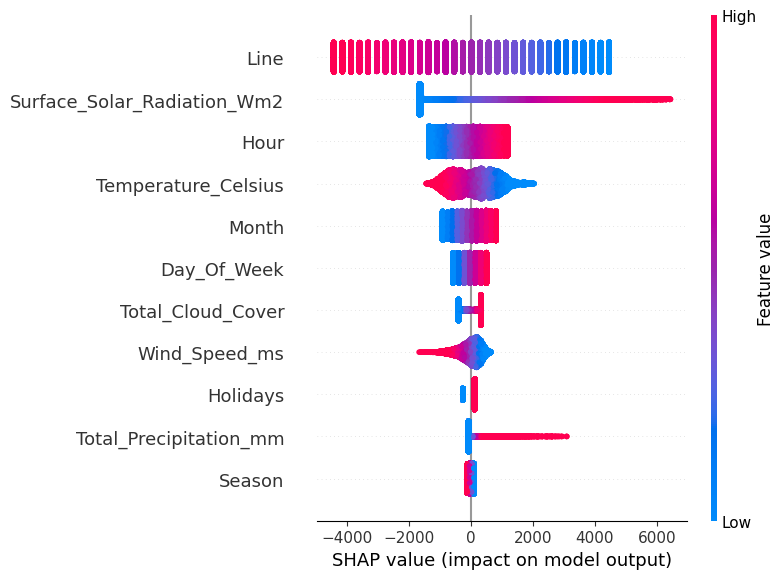

In [71]:
shap.summary_plot(shap_values, test_data[selected_features], feature_names=selected_features)

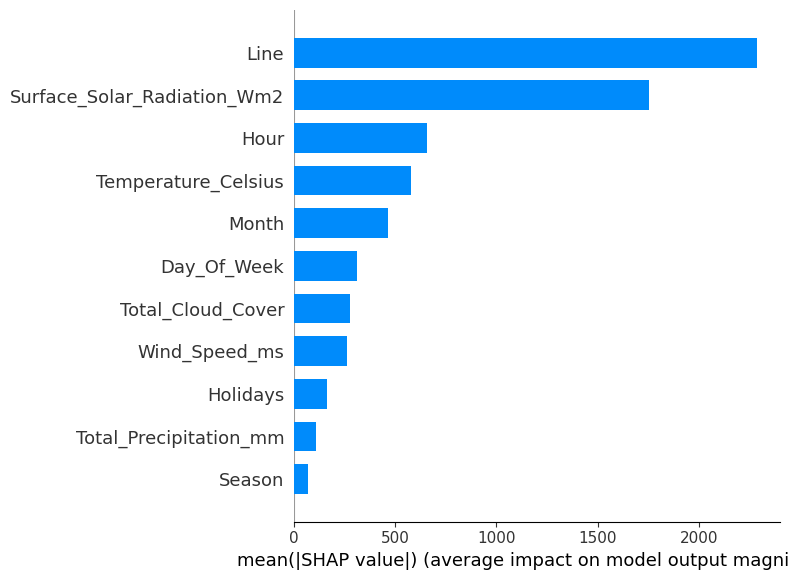

In [72]:
shap.summary_plot(shap_values, test_data[selected_features], feature_names=selected_features, plot_type='bar')

In [73]:
# Mean of absolute SHAP values for each variable
mean_abs_shap_values = np.abs(shap_values).mean(axis=0)

# DataFrame with variables and mean absolute SHAP values
shap_summary_df = pd.DataFrame({
    'Variable': selected_features,
    'Mean_Abs_SHAP': mean_abs_shap_values
})

# Sort the DataFrame in descending order of mean absolute SHAP values
shap_summary_df = shap_summary_df.sort_values(by='Mean_Abs_SHAP', ascending=False)

shap_summary_df

,Variable,Mean_Abs_SHAP
0,Line,2287.467271
3,Surface_Solar_Radiation_Wm2,1756.672153
8,Hour,659.046236
1,Temperature_Celsius,579.725426
6,Month,464.754614
7,Day_Of_Week,309.447348
4,Total_Cloud_Cover,276.213820
2,Wind_Speed_ms,261.372997
10,Holidays,161.333245
5,Total_Precipitation_mm,110.838820


We can observe the absolute averages of 'shapley' values ​​of each variable, i.e. the contribution of the variables in the Lasso model. Variables with high SHAP values ​​were favored by the Lasso model, and contributed significantly to its predictions.

## Non-parametric models based on decision trees

### Decision Tree

In [46]:
# Decision tree model with depth 4
tree_model = DecisionTreeRegressor(max_depth=4).fit(train_data[selected_features], train_data['Ridership'])

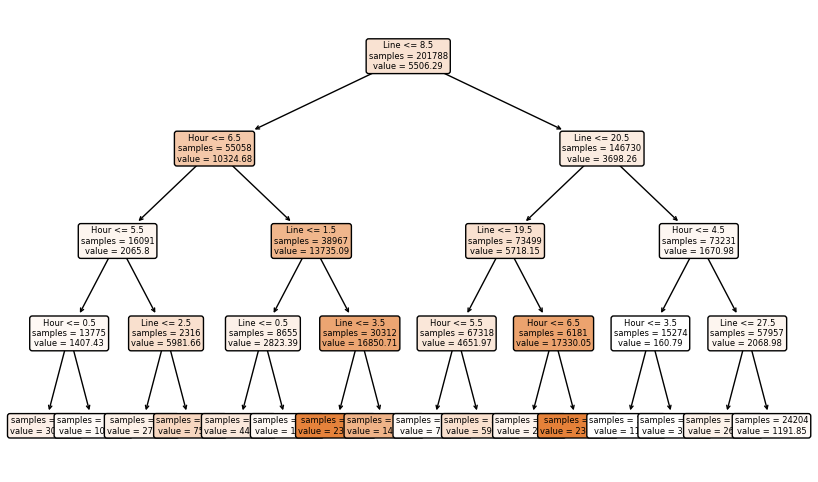

In [76]:
# Graphic
plt.figure(figsize=(10, 6)) 
plot_tree(tree_model, feature_names=selected_features, 
          filled=True, 
          rounded=True, 
          fontsize=6, 
          impurity=False, 
          label="all",  
          precision=2)
plt.show()

In [47]:
# Model evaluation
tree_predictions_train = tree_model.predict(train_data[selected_features])
tree_predictions_test = tree_model.predict(test_data[selected_features])

# Predictions on test_data
test_data['tree_predictions'] = tree_predictions_test
print(test_data[['Ridership', 'tree_predictions']])

# Metrics evaluation
r2_tree_model = r2_score(test_data['Ridership'], tree_predictions_test)
print("R-squared (R2):", r2_tree_model)

mse_tree_train = mean_squared_error(train_data['Ridership'], tree_predictions_train)
mse_tree_test = mean_squared_error(test_data['Ridership'], tree_predictions_test)
ecart_mse_tree = mse_tree_test - mse_tree_train

print("\nMean Squared Error on training set:", mse_tree_train)
print("Mean Squared Error on validation set:", mse_tree_test)
print("\nThe difference between the two MSE is:", ecart_mse_tree)

        Ridership  tree_predictions
190997        816       2697.960063
36058        4507      14231.035891
278620        156        117.151421
178524      20439      23613.388418
24913         711       1096.345001
...           ...               ...
53947       20273      14231.035891
47053        6498      14231.035891
196876        755       2697.960063
236311        201        117.151421
253159         99        117.151421

[86481 rows x 2 columns]
R-squared (R2): 0.44813003786780303

Mean Squared Error on training set: 46836557.01306907
Mean Squared Error on validation set: 48227885.59577529

The difference between the two MSE is: 1391328.5827062204


### Random Forest

In [51]:
# Random Forest Model
rf_model = RandomForestRegressor(n_estimators=10).fit(train_data[selected_features], train_data['Ridership'])

In [52]:
# Feature importance graph

# Variable importance from the random forest model
importances = pd.DataFrame({'Feature': selected_features, 'Importance': rf_model.feature_importances_})

# Sort variables by importance
importances = importances.sort_values(by='Importance')

# Graph with Plotly Express
fig = px.bar(importances, x='Importance', y='Feature', orientation='h',
             title='Variable Importance in Random Forest',
             labels={'Importance': 'Relative Importance', 'Feature': 'Variable'})

fig.show()

In [49]:
# Model evaluation for Random Forest

# Predictions on training and test sets
rf_predictions_train = rf_model.predict(train_data[selected_features])
rf_predictions_test = rf_model.predict(test_data[selected_features])

# Displaying predictions on test_data
test_data['rf_predictions'] = rf_predictions_test
print(test_data[['Ridership', 'rf_predictions']])

# Metrics evaluation
r2_rf_model = r2_score(test_data['Ridership'], rf_predictions_test)
print("R-squared (R2):", r2_rf_model)

mse_rf_train = mean_squared_error(train_data['Ridership'], rf_predictions_train)
mse_rf_test = mean_squared_error(test_data['Ridership'], rf_predictions_test)
ecart_mse_rf = mse_rf_test - mse_rf_train

print("\nMean Squared Error on training set:", mse_rf_train)
print("Mean Squared Error on validation set:", mse_rf_test)
print("\nThe difference between the two MSE is:", ecart_mse_rf)

        Ridership  rf_predictions
190997        816           770.1
36058        4507          4733.0
278620        156           347.7
178524      20439         20722.1
24913         711           609.8
...           ...             ...
53947       20273         20887.0
47053        6498          6736.0
196876        755           755.1
236311        201           247.2
253159         99            94.7

[86481 rows x 2 columns]
R-squared (R2): 0.9813716428313588

Mean Squared Error on training set: 290870.4383308719
Mean Squared Error on validation set: 1627931.106986506

The difference between the two MSE is: 1337060.668655634


### XGBoost

In [10]:
# Training the classic XGBoost model
xgb_model = XGBRegressor().fit(train_data[selected_features], train_data['Ridership'])

# Model evaluation
xgboost_predictions_train = xgb_model.predict(train_data[selected_features])
xgboost_predictions_test = xgb_model.predict(test_data[selected_features])

# Displaying predictions on test_data
test_data['xgboost_predictions'] = xgboost_predictions_test
print(test_data[['Ridership', 'xgboost_predictions']])

# Metrics evaluation
r2_xgboost_model = r2_score(test_data['Ridership'], xgboost_predictions_test)
print("R-squared (R2):", r2_xgboost_model)

mse_xgboost_train = mean_squared_error(train_data['Ridership'], xgboost_predictions_train)
mse_xgboost_test = mean_squared_error(test_data['Ridership'], xgboost_predictions_test)
ecart_mse_xgboost = mse_xgboost_test - mse_xgboost_train

print("\nMean Squared Error on training set:", mse_xgboost_train)
print("Mean Squared Error on validation set:", mse_xgboost_test)
print("\nThe difference between the two MSE is:", ecart_mse_xgboost)

        Ridership  xgboost_predictions
190997        816          1298.013672
36058        4507          3854.854736
278620        156           144.156586
178524      20439         20925.060547
24913         711          1942.574707
...           ...                  ...
53947       20273         20370.806641
47053        6498          5583.098145
196876        755           836.076843
236311        201          -894.921204
253159         99           -26.360527

[86481 rows x 2 columns]
R-squared (R2): 0.9688913938381225

Mean Squared Error on training set: 2384443.164305662
Mean Squared Error on validation set: 2718579.3791394457

The difference between the two MSE is: 334136.2148337839


In [84]:
# Improvement of the model by searching for the best parameters with Gridcv
param_grid = {
    'learning_rate': [0.01, 0.1, 0.2],  # Model learning rate
    'n_estimators': [100, 200, 300],  # Number of decision trees generated
    'max_depth': [4, 6, None] # Tree depth
}

# Creating the XGBoost model
xgb_model = XGBRegressor()

# GridSearchCV for hyperparameter tuning
grid_search = GridSearchCV(xgb_model, param_grid, cv=3, scoring='neg_mean_squared_error')
grid_search.fit(train_data[selected_features], train_data['Ridership'])

# Best hyperparameters from the grid search
best_hyperparameters = grid_search.best_params_

# Best hyperparameters chosen by GridSearchCV
print("Best Hyperparameters:")
print("Learning Rate:", best_hyperparameters['learning_rate'])
print("Number of Estimators:", best_hyperparameters['n_estimators'])
print("Max Depth:", best_hyperparameters['max_depth'])

Best Hyperparameters:
Learning Rate: 0.2
Number of Estimators: 300
Max Depth: 6


In [105]:
# Training the XGBoost model with the best hyperparameters
best_xgb_model = XGBRegressor(**best_hyperparameters)
model_xgb = best_xgb_model.fit(train_data[selected_features], train_data['Ridership'])

# Model evaluation
xgboost_predictions_train = model_xgb.predict(train_data[selected_features])
xgboost_predictions_test = model_xgb.predict(test_data[selected_features])

test_data['xgboost_predictions'] = xgboost_predictions_test

# Display the results
print(test_data[['Ridership', 'xgboost_predictions']])

# Metrics evaluation
r2_xgboost_model = r2_score(test_data['Ridership'], xgboost_predictions_test)
print("R-squared (R2):", r2_xgboost_model)

mse_xgboost_train = mean_squared_error(train_data['Ridership'], xgboost_predictions_train)
mse_xgboost_test = mean_squared_error(test_data['Ridership'], xgboost_predictions_test)
ecart_mse_xgboost = mse_xgboost_test - mse_xgboost_train

print("\nMean Squared Error on training set:", mse_xgboost_train)
print("Mean Squared Error on validation set:", mse_xgboost_test)
print("\nThe difference between the two MSE is:", ecart_mse_xgboost)

        Ridership  xgboost_predictions
190997        816          1047.767334
36058        4507          4526.785645
278620        156           226.087418
178524      20439         19113.132812
24913         711          1416.574707
...           ...                  ...
53947       20273         20486.978516
47053        6498          6989.097168
196876        755           779.468750
236311        201          -606.358154
253159         99             2.115562

[86481 rows x 2 columns]
R-squared (R2): 0.9790184369838175

Mean Squared Error on training set: 1469527.9532239954
Mean Squared Error on validation set: 1833577.6363972572

The difference between the two MSE is: 364049.6831732618


The model has a higher R2, but it exhibits more overfitting than the regular xgboost model. We can adapt the settings ourselves

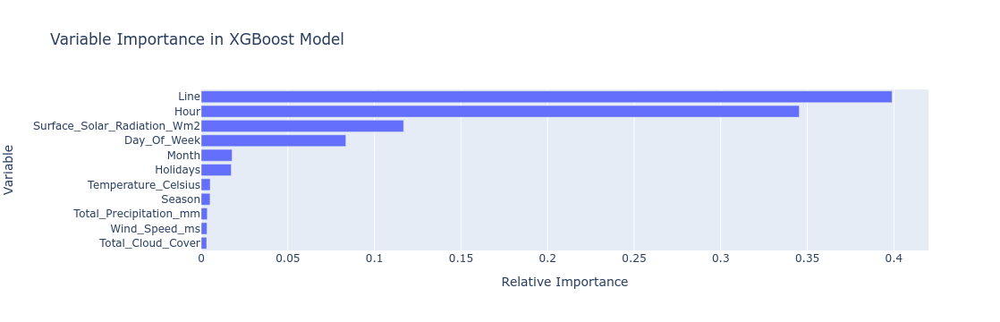

In [50]:
# Feature importance graph for XGBoost model

# Extract variable importance from the XGBoost model
importances = pd.DataFrame({'Feature': selected_features, 'Importance': model_xgb.feature_importances_})

# Sort variables by importance
importances = importances.sort_values(by='Importance')

# Graph with Plotly Express
fig = px.bar(importances, x='Importance', y='Feature', orientation='h',
             title='Variable Importance in XGBoost Model',
             labels={'Importance': 'Relative Importance', 'Feature': 'Variable'})

fig.show()

## Model validation

In [59]:
test_data[["Ridership", "linear_predictions", "lasso_predictions", "tree_predictions", "rf_predictions", "xgboost_predictions"]]

,Ridership,linear_predictions,lasso_predictions,tree_predictions,rf_predictions,xgboost_predictions
190997,816,4934.812366,3853.309596,2697.960063,770.1,1047.767334
36058,4507,6003.904780,7369.980315,14231.035891,4733.0,4526.785645
278620,156,2043.329451,-88.131751,117.151421,347.7,226.087418
178524,20439,6808.915505,6870.954554,23613.388418,20722.1,19113.132812
24913,711,10024.031409,8237.308578,1096.345001,609.8,1416.574707
...,...,...,...,...,...,...
53947,20273,10992.550616,11068.379781,14231.035891,20887.0,20486.978516
47053,6498,11857.944888,11297.104224,14231.035891,6736.0,6989.097168
196876,755,1343.805117,2092.066660,2697.960063,755.1,779.468750
236311,201,-554.377405,-1026.731376,117.151421,247.2,-606.358154


In [62]:
# DataFrame with metrics
models = ['Linear Regression', 'Lasso', 'Decision Tree', 'RandomForest', 'XGBoost']

metrics_df = pd.DataFrame({
    'R2': [r2_linear_model, r2_lasso_model, r2_tree_model, r2_rf_model, r2_xgboost_model],
    'MSE_train': [mse_linear_train, mse_lasso_train, mse_tree_train, mse_rf_train, mse_xgboost_train],
    'MSE_test': [mse_linear_test, mse_lasso_test, mse_tree_test, mse_rf_test, mse_xgboost_test],
    'Adjustment': [ecart_mse_linear, ecart_mse_lasso, ecart_mse_tree, ecart_mse_rf, ecart_mse_xgboost]
}, index=models)

# Round values to 2 decimal places
metrics_df = metrics_df.round(2)

metrics_df

,R2,MSE_train,MSE_test,Adjustment
Linear Regression,0.14,73427412.26,75162060.17,1734647.91
Lasso,0.15,72265076.42,74014456.83,1749380.41
Decision Tree,0.45,46836557.01,48227885.60,1391328.58
RandomForest,0.98,290870.44,1627931.11,1337060.67
XGBoost,0.98,1469527.95,1833577.64,364049.68


/tmp/ipykernel_9973/2717662104.py:8: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/tmp/ipykernel_9973/2717662104.py:9: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




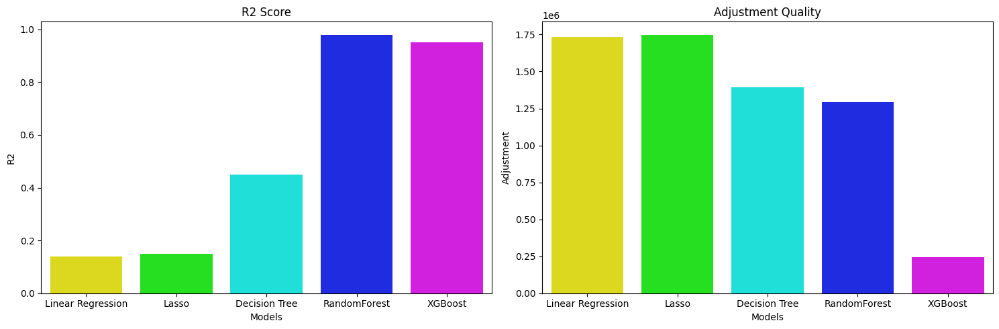

In [114]:
metrics_df_reset = metrics_df.reset_index()

# Rainbow color palette
rainbow_palette = sns.color_palette("hsv", len(models))

# Plots
fig, ax = plt.subplots(1, 2, figsize=(15, 5))
sns.barplot(x='index', y='R2', data=metrics_df_reset, ax=ax[0], palette=rainbow_palette)       # R2
sns.barplot(x='index', y='Adjustment', data=metrics_df_reset, ax=ax[1], palette=rainbow_palette)   # Adjustment
ax[0].set_title('R2 Score')
ax[1].set_title('Adjustment Quality')
ax[0].set_xlabel('Models')
ax[1].set_xlabel('Models')
plt.tight_layout()
plt.show()

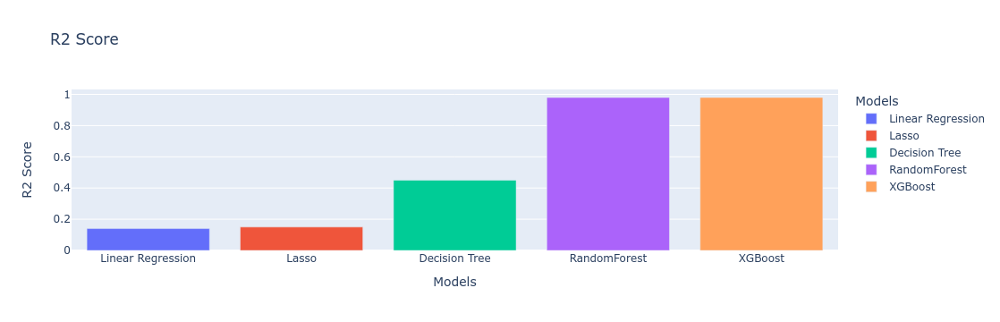

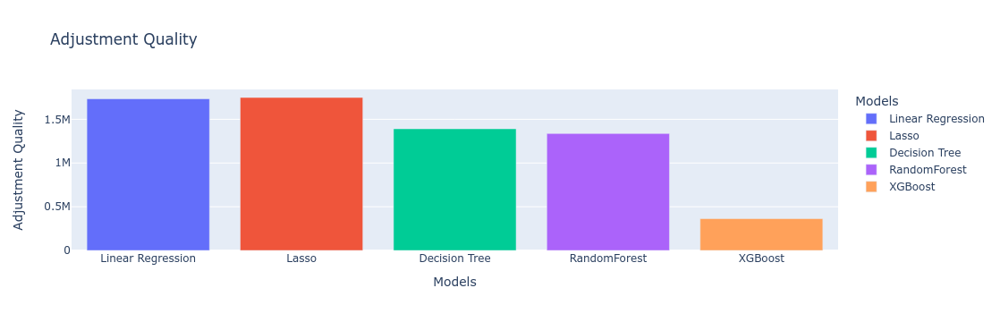

In [66]:
# Reset index of the metrics_df
metrics_df_reset = metrics_df.reset_index()

# Plot R2 Score
fig_r2 = px.bar(metrics_df_reset, x='index', y='R2', title='R2 Score', labels={'index': 'Models', 'R2': 'R2 Score'},
                color='index', color_discrete_sequence=px.colors.qualitative.Plotly)
fig_r2.show()

# Plot Adjustment Quality
fig_adj = px.bar(metrics_df_reset, x='index', y='Adjustment', title='Adjustment Quality', labels={'index': 'Models', 'Adjustment': 'Adjustment Quality'},
                 color='index', color_discrete_sequence=px.colors.qualitative.Plotly)
fig_adj.show()

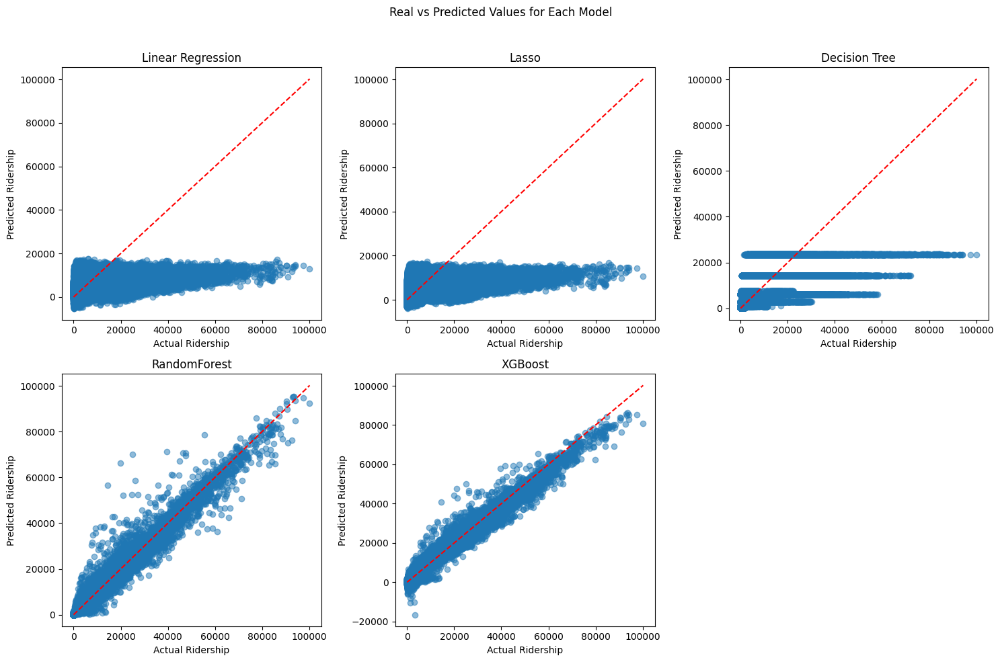

In [98]:
# Create a flexible matrix of plots
num_models = len(models)
num_rows = int(np.ceil(num_models / 3))
fig, axes = plt.subplots(nrows=num_rows, ncols=3, figsize=(15, 5 * num_rows))
fig.suptitle('Real vs Predicted Values for Each Model')

# Fill the matrix with plots
for i, model in enumerate(models):
    row, col = divmod(i, 3)
    axes[row, col].scatter(test_data['Ridership'], predicted_values[model], alpha=0.5)
    axes[row, col].plot([min(test_data['Ridership']), max(test_data['Ridership'])],
                       [min(test_data['Ridership']), max(test_data['Ridership'])], color='red', linestyle='--')
    axes[row, col].set_title(model)
    axes[row, col].set_xlabel('Actual Ridership')
    axes[row, col].set_ylabel('Predicted Ridership')

# Remove empty subplots
for i in range(num_models, num_rows * 3):
    fig.delaxes(axes.flatten()[i])

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

/home/leaaumagy/.local/lib/python3.9/site-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



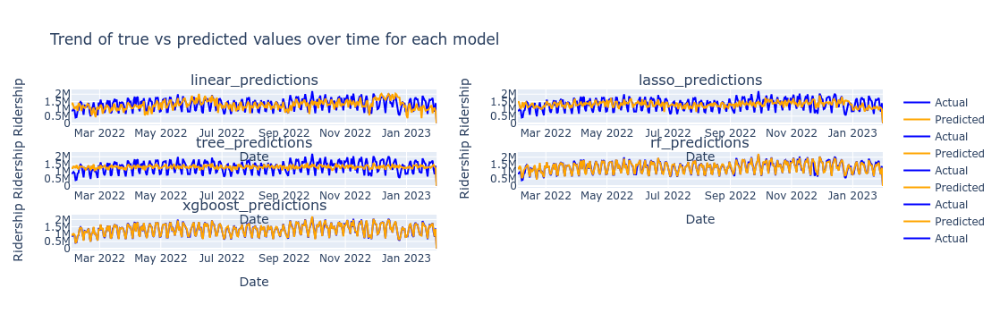

In [84]:
# Group by Date and sum the ridership for each model
agg_ridership_model = test_data.groupby(['Date']).agg({
    'Ridership': 'sum',
    'linear_predictions': 'sum',
    'tree_predictions': 'sum',
    'rf_predictions': 'sum',
    'xgboost_predictions': 'sum',
    'lasso_predictions': 'sum'
}).reset_index()

fig = make_subplots(rows=3, cols=2, subplot_titles=models)

# Plot trends for each model
for i, model in enumerate(models):
    row, col = divmod(i, 2)

    # True values plot
    true_trace = go.Scatter(
        x=agg_ridership_model['Date'],
        y=agg_ridership_model['Ridership'],
        mode='lines',
        name='Actual',
        line=dict(color='blue')
    )

    # Predicted values plot
    predicted_trace = go.Scatter(
        x=agg_ridership_model['Date'],
        y=agg_ridership_model[model],
        mode='lines',
        name='Predicted',
        line=dict(color='orange')
    )

    fig.add_trace(true_trace, row=row + 1, col=col + 1)
    fig.add_trace(predicted_trace, row=row + 1, col=col + 1)
    fig.update_xaxes(title_text='Date', row=row + 1, col=col + 1)
    fig.update_yaxes(title_text='Ridership', row=row + 1, col=col + 1)

fig.update_layout(
    title='Trend of true vs predicted values over time for each model',
    height=15 * 65, 
)

fig.show()

## Prediction

We will use the XGboost model to make predictions for the year 2023 then for the future year 2024

In [43]:
# Loading the meteorological database for 2023
weather_2023 = pd.read_csv("/home/leaaumagy/M2/Subway/Données/Weather_NYC.csv")
weather_2023['Date'] = pd.to_datetime(weather_2023['Date'])

# Filtering data for 2023
start_date = pd.to_datetime("2023-01-01")
end_date = pd.to_datetime("2023-12-31")
weather_2023 = weather_2023[(weather_2023['Date'] >= start_date) & (weather_2023['Date'] <= end_date)]

# Rename variables
column_mapping = {
    'temperature (degC)': 'Temperature_Celsius',
    'dewpoint_temperature (degC)': 'Dewpoint_Temperature_Celsius',
    'humidex_index (degC)': 'Humidex_Index_Celsius',
    'wind_speed (m/s)': 'Wind_Speed_ms',
    'surface_solar_radiation (W/m^2)': 'Surface_Solar_Radiation_Wm2',
    'total_cloud_cover (0-1)': 'Total_Cloud_Cover',
    'total_precipitation (mm of water equivalent)': 'Total_Precipitation_mm',
    'snowfall (mm of water equivalent)': 'Snowfall_mm'
}

weather_2023 = weather_2023.rename(columns=column_mapping)
weather_2023 = weather_2023[['Date', 'Hour', 'Temperature_Celsius', 'Wind_Speed_ms', 'Surface_Solar_Radiation_Wm2', 'Total_Cloud_Cover', 'Total_Precipitation_mm']]

# Add a column for the month
weather_2023['Month'] = weather_2023['Date'].dt.month

# Add a column for the day of the month
weather_2023['Day'] = weather_2023['Date'].dt.day

# Add a "Day_Of_Week" column with the day of the week
weather_2023['Day_Of_Week'] = weather_2023['Date'].dt.day_name()

# Add a column for the season
weather_2023['Season'] = weather_2023['Date'].dt.month.map({1: 'Winter', 2: 'Winter', 3: 'Spring', 
                                                      4: 'Spring', 5: 'Spring', 6: 'Summer', 
                                                      7: 'Summer', 8: 'Summer', 9: 'Autumn', 
                                                      10: 'Autumn', 11: 'Autumn', 12: 'Winter'})

# Holiday periods
holidays_periods = {
    'Rosh Hashanah': ('2023-09-26', '2023-09-27'),
    'Yom Kippur': ('2023-10-05', '2023-10-05'),
    'Thanksgiving': ('2023-11-24', '2023-11-25'),
    'Winter Recess 2024' : ('2023-12-25', '2024-01-02'),
    'Martin Luther King Jr. Day': ('2023-01-16', '2023-01-16'),
    'Midwinter Recess': ('2023-02-20', '2023-02-24'),
    'Spring Recess': ('2023-04-10', '2023-04-14'),
    'Summer': ('2023-06-27', '2023-09-08'),
    'Winter Recess 2023': ('2022-12-26', '2023-01-02')
}

# Create a 'Holidays' column with the corresponding days
weather_2023['Holidays'] = np.select(
    [weather_2023['Date'].between(start_date, end_date) for start_date, end_date in holidays_periods.values()],
    holidays_periods.keys(),
    default='Not Holidays'
)

# Replace holiday periods with 'Holidays'
holidays_to_replace = ['Summer', 'Winter Recess 2023', 'Winter Recess 2024', 'Spring Recess', 'Midwinter Recess',
                        'Thanksgiving', 'Rosh Hashanah', 'Yom Kippur', 'Martin Luther King Jr. Day']
weather_2023.loc[weather_2023['Holidays'].isin(holidays_to_replace), 'Holidays'] = 'Holidays'

# Convert categorical variables
label_encoder = LabelEncoder()
weather_2023['Season'] = label_encoder.fit_transform(weather_2023['Season'])
weather_2023['Day_Of_Week'] = label_encoder.fit_transform(weather_2023['Day_Of_Week'])
weather_2023['Holidays'] = label_encoder.fit_transform(weather_2023['Holidays'])

subway_lines = pd.DataFrame({'Line': range(0, 33)})
# Create a key column to merge on 
weather_2023['key'] = 1
subway_lines['key'] = 1

# Merge weather_2023 with subway_lines to create a Cartesian product
subway_2023 = pd.merge(weather_2023, subway_lines, on='key').drop(columns='key')

subway_2023.head(3)

,Date,Hour,Temperature_Celsius,Wind_Speed_ms,Surface_Solar_Radiation_Wm2,Total_Cloud_Cover,Total_Precipitation_mm,Month,Day,Day_Of_Week,Season,Holidays,Line
0,2023-01-01,0,9.4,2.82,0.0,1.0,0.58,1,1,3,3,0,0
1,2023-01-01,0,9.4,2.82,0.0,1.0,0.58,1,1,3,3,0,1
2,2023-01-01,0,9.4,2.82,0.0,1.0,0.58,1,1,3,3,0,2


In [116]:
# Prediction for 2023
xgboost_predictions_2023 = model_xgb.predict(subway_2023[selected_features])
subway_2023['Ridership'] = pd.Series(xgboost_predictions_2023).round().astype(int)

subway_2023.head(3)

,Date,Hour,Temperature_Celsius,Wind_Speed_ms,Surface_Solar_Radiation_Wm2,Total_Cloud_Cover,Total_Precipitation_mm,Month,Day,Day_Of_Week,Season,Holidays,Line,Ridership
0,2023-01-01,0,9.4,2.82,0.0,1.0,0.58,1,1,3,3,0,1,1128
1,2023-01-01,0,9.4,2.82,0.0,1.0,0.58,1,1,3,3,0,2,5141
2,2023-01-01,0,9.4,2.82,0.0,1.0,0.58,1,1,3,3,0,3,6977


/home/leaaumagy/.local/lib/python3.9/site-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



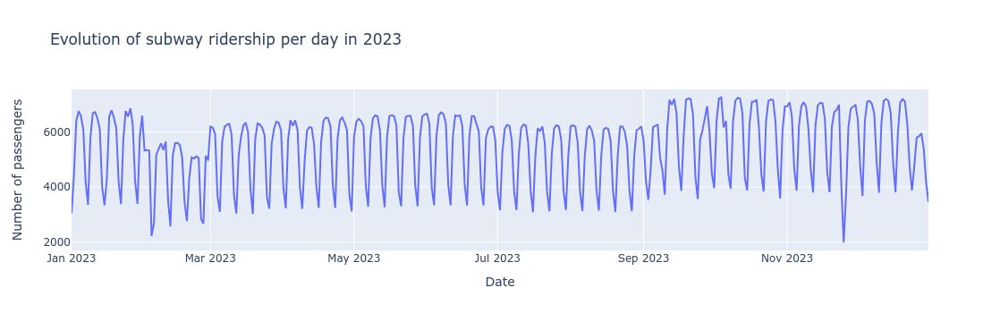

In [117]:
# Passenger trend
mean_ridership_2023 = subway_2023.groupby('Date')['Ridership'].mean().reset_index()

# Plot of ridership evolution per day
fig = px.line(mean_ridership_2023, x='Date', y='Ridership', title="Evolution of subway ridership per day in 2023")
fig.update_xaxes(title='Date')
fig.update_yaxes(title='Number of passengers')

fig.show()

## To go further... Classification according to the type of crowd: low, moderate, high, huge

This method could also be envisaged to help users of the MTA public transport itinerary application to anticipate transport congestion by choosing other, more appropriate itineraries, particularly for individuals who do not like to take public transport in very busy conditions.

In [119]:
# Calculating quartiles
Q1 = subway['Ridership'].quantile(0.25)
Q2 = subway['Ridership'].quantile(0.50)
Q3 = subway['Ridership'].quantile(0.75)

print(f"Q1: {Q1}")
print(f"Q2 (median): {Q2}")
print(f"Q3: {Q3}")

Q1: 490.0
Q2 (median): 1751.0
Q3: 5992.0


In [120]:
# Calculating quantiles to determine ridership levels
subway['Crowd_Level'] = pd.qcut(subway['Ridership'], q=[0, 0.25, 0.5, 0.75, 1], labels=['Low', 'Moderate', 'High', 'Huge'])
subway.head(3)

,Line,Date,Hour,Month,Day,Day_Of_Week,Season,Holidays,Ridership,Temperature_Celsius,Dewpoint_Temperature_Celsius,Humidex_Index_Celsius,Wind_Speed_ms,Surface_Solar_Radiation_Wm2,Total_Cloud_Cover,Total_Precipitation_mm,Snowfall_mm,Crowd_Level
0,0,2022-02-01,0,2,1,5,3,1,236,-4.98,-11.22,-9.08,3.29,0.0,0.03,0.0,0.0,Low
1,0,2022-02-01,1,2,1,5,3,1,73,-6.08,-11.31,-10.20,3.50,0.0,0.05,0.0,0.0,Low
2,0,2022-02-01,2,2,1,5,3,1,75,-6.77,-11.44,-10.90,3.56,0.0,0.19,0.0,0.0,Low


In [121]:
# Convert categorical labels to numerical values
crowd_level_mapping = {'Low': 0, 'Moderate': 1, 'High': 2, 'Huge': 3}
subway['Crowd_Level'] = subway['Crowd_Level'].map(crowd_level_mapping)

In [124]:
# Separating the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(subway[selected_features], subway['Crowd_Level'], test_size=0.2, random_state=42)

# Selecting hyperparameters
hyperparameters = {
    'learning_rate': 0.1,
    'n_estimators': 100,
    'max_depth': None,
    'objective': 'multi:softmax',
    'num_class': len(subway['Crowd_Level'].unique())
}

# Creating the XGBoost model
xgb_model = XGBClassifier(**hyperparameters)

# Training the model
xgb_model.fit(X_train, y_train)

# Predictions on the test set
y_pred = xgb_model.predict(X_test)

# Evaluating accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f"XGBoost Model Accuracy: {accuracy}")

XGBoost Model Accuracy: 0.9053664966871335


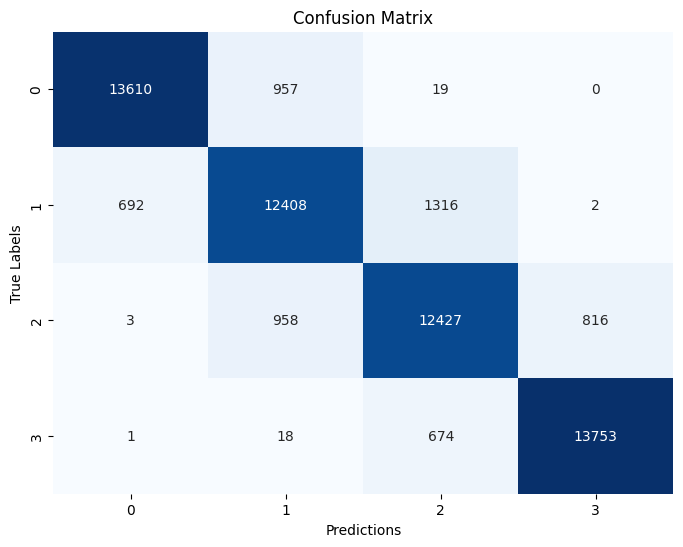

In [125]:
# Confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.xlabel('Predictions')
plt.ylabel('True Labels')
plt.title('Confusion Matrix')
plt.show()

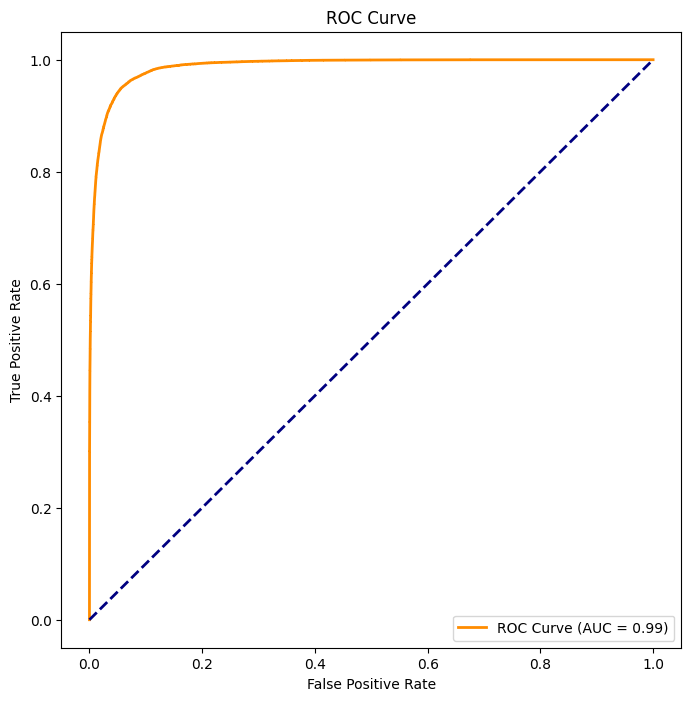

In [132]:
y_scores = xgb_model.predict_proba(X_test)

# Calculating the AUC
roc_auc = roc_auc_score(label_binarize(y_test, classes=[0, 1, 2, 3]), y_scores, average='macro')

# Calculating ROC curves for each class
fpr, tpr, _ = roc_curve(label_binarize(y_test, classes=[0, 1, 2, 3]).ravel(), y_scores.ravel())

# Displaying the ROC curve
plt.figure(figsize=(8, 8))
plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC Curve (AUC = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend(loc="lower right")
plt.show()